In [148]:
!rm -r /workspace/content/frames_4/

^C


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!unzip -q drive/MyDrive/Colab\ Notebooks/GameGPT/frames_3.zip -d "/content/"

In [1]:
import string
import numpy as np
import json
import torch
import torch.nn.functional as F
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import math
import os
import gc

In [2]:
# Check if CUDA is available
print("CUDA Available:", torch.cuda.is_available())

# Print the number of GPUs available
print("Number of GPUs:", torch.cuda.device_count())

# Print the name of the GPU
if torch.cuda.is_available():
    print("GPU Name:", torch.cuda.get_device_name(0))
    
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

CUDA Available: True
Number of GPUs: 1
GPU Name: NVIDIA GeForce RTX 2070


device(type='cuda')

In [3]:
parent_dir = "drive/MyDrive/Colab Notebooks/GameGPT/"
parent_dir = ""
content_dir = f"/content/{parent_dir}"
content_dir = f"content/{parent_dir}"


In [4]:
datasetnames = ('content/frames_7', 'moves_7')

# Read Movements on each frame

In [5]:
moves_file_path = f'{content_dir}{datasetnames[1]}.json'

# Load moves from the JSON file
with open(moves_file_path, 'r') as json_file:
    moves = json.load(json_file)
value_to_int_mapping = {'Q': 0}
unique_values = [value for value in set(moves.values()) if value != 'Q']
value_to_int_mapping.update({value: i + 1 for i, value in enumerate(unique_values)})
int_to_value_mapping = {v: k for k, v in value_to_int_mapping.items()}

override = True
if override:
    value_to_int_mapping = {'Q': 0, 'L': 1, 'N': 2, 'R': 3}
    int_to_value_mapping = {0: 'Q', 1: 'L', 2: 'N', 3: 'R'}
    
# Create a new dictionary with integer values
new_moves = {key: value_to_int_mapping[value] for key, value in moves.items()}

In [6]:
value_to_int_mapping

{'Q': 0, 'L': 1, 'N': 2, 'R': 3}

In [7]:
int_to_value_mapping

{0: 'Q', 1: 'L', 2: 'N', 3: 'R'}

In [8]:
class AddInverseBellShapeNoise(object):
    def __init__(self, max_noise=0.1, sigma=0.5):
        self.max_noise = max_noise
        self.sigma = sigma
    
    def __call__(self, img):
        img_np = np.array(img)
        height, width, _ = img_np.shape

        # Create a coordinate grid
        x = np.arange(width)
        y = np.arange(height)
        x, y = np.meshgrid(x, y)

        # Calculate the distance from the center
        center_x, center_y = width // 2, height // 2
        distance = np.sqrt((x - center_x)**2 + (y - center_y)**2)

        # Normalize distance to [0, 1]
        max_distance = np.sqrt(center_x**2 + center_y**2)
        normalized_distance = distance / max_distance

        # Create inverse bell shape noise map
        noise_map = self.max_noise * (1 - np.exp(- (normalized_distance**2) / (2 * self.sigma**2)))

        # Generate noise and add it to the image
        noise = np.random.uniform(0, 1, img_np.shape) * noise_map[:, :, np.newaxis]
        noisy_img_np = img_np + (noise * 255)
        
        # Clip values to be in [0, 255] range
        noisy_img_np = np.clip(noisy_img_np, 0, 255).astype(np.uint8)
        
        # Convert back to PIL image
        noisy_img = Image.fromarray(noisy_img_np)
        return noisy_img

## Create Train Dataset

*  frames: list of previous {seq_len} frames
*  moves: list of input keys, one for each frame
*  target_frames: for every {seq_len} frames there will be a target_frame






In [9]:
class CustomDataset(Dataset):
    def __init__(self, data_folder, moves_dict, seq_len, transform=None, transform_target=None):
        self.data_folder = data_folder
        self.moves_dict = moves_dict
        self.transform = transform
        self.transform_target = transform_target
        self.seq_len = seq_len

        # Get a list of all image filenames in the data folder
        self.image_filenames = [filename for filename in os.listdir(data_folder) if filename.endswith('.png')]

    def __len__(self):
        return len(self.image_filenames) - 2  # We subtract 5 for the sequence length

    def __getitem__(self, idx):
        # Get 5 consecutive frames and their moves
        frames = [Image.open(os.path.join(self.data_folder, f'frame_{idx + i}.png')) for i in range(self.seq_len) if idx + i < len(self.image_filenames) - 2]
        moves = [self.moves_dict[f"{idx + i}"] for i in range(self.seq_len) if idx + i < len(self.image_filenames) - 2]

        # Apply transformations to each frame
        if self.transform is not None:
            frames = [self.transform(frame) for frame in frames]

        # Prepare the target frames for each frame in the sequence
        target_frames = [Image.open(os.path.join(self.data_folder, f'frame_{idx + 1 + i}.png')) for i in range(self.seq_len) if idx + 1 + i < len(self.image_filenames) - 1]

        # Apply transformations to the target frame
        if self.transform is not None:
            target_frames = [self.transform_target(frame) for frame in target_frames]

        if len(frames) == self.seq_len and len(frames) == len(moves) == len(target_frames):
          frames = torch.stack(frames)
          moves = torch.tensor(moves)
          target_frames = torch.stack(target_frames)
        else:
          return self.__getitem__(idx - 1)

        return {'frames': frames, 'moves': moves, 'target_frames': target_frames}

# Define a transform for preprocessing images
data_transform = transforms.Compose([
    transforms.Resize((128, 128)),
    #AddInverseBellShapeNoise(max_noise=0.7, sigma=0.3),
    transforms.ToTensor(),
])
data_transform_target = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

# Model Definition
Basic Image To Vector Encoder

In [10]:
class ImageToVector(nn.Module):
    def __init__(self, input_channels, image_size, conv_size, d_model, dropout):  # Change output_size to 256
        super(ImageToVector, self).__init__()

        # First Convolutional block with ReLU and MaxPooling
        self.conv1 = nn.Conv2d(input_channels, conv_size, kernel_size=3, stride=1, padding=1)
        self.relu1 = nn.ReLU(inplace=True)
        self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)

        # Second Convolutional block with ReLU and MaxPooling
        self.conv2 = nn.Conv2d(conv_size, conv_size * 2, kernel_size=3, stride=1, padding=1)
        self.relu2 = nn.ReLU(inplace=True)
        self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.flatten = nn.Flatten()

        # Adjusting the input size of the fully connected layer to match new dimensions
        self.fc = nn.Linear((image_size // 4) * (image_size // 4) * conv_size * 2, d_model) 
        self.relu = nn.ReLU(inplace=True)
        self.dropout = nn.Dropout(dropout)

    def forward(self, x):
        # First block
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.pool1(x)

        # Second block
        x = self.conv2(x)
        x = self.relu2(x)
        x = self.pool2(x)

        # Flatten and pass through fully connected layers
        x = self.flatten(x)
        x = self.relu(self.fc(x))
        x = self.dropout(x)

        return x

Input Vector Positional Encoding

In [11]:
class PositionalEncoding(nn.Module):
    def __init__(self, d_model, max_seq_len):  # Dynamically set d_model
        super(PositionalEncoding, self).__init__()
        self.encoding = torch.zeros(max_seq_len, d_model).to(device)
        position = torch.arange(0, max_seq_len).unsqueeze(1).float()
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * -(torch.log(torch.tensor(10000.0)) / d_model))
        self.encoding[:, 0::2] = torch.sin(position * div_term)
        self.encoding[:, 1::2] = torch.cos(position * div_term)
        self.encoding = self.encoding.unsqueeze(0)

    def forward(self, x):
        return x + self.encoding[:, :x.size(1)]

Self Attention Layer

In [12]:
class Attention(nn.Module):
    def __init__(self, d_model, n_head, seq_len, dropout):
        super(Attention, self).__init__()
        
        assert d_model % n_head == 0, "d_model must be divisible by n_head"
        self.c_attn = nn.Linear(d_model, 3 * d_model)
        self.linear = nn.Linear(d_model, d_model)
        self.dropout = nn.Dropout(dropout)
        self.norm = nn.LayerNorm(d_model)
        
        self.register_buffer('tril', torch.tril(torch.ones(seq_len, seq_len)))
        self.d_model = d_model
        self.n_head = n_head

    def forward(self, x):
        B, T, C = x.shape


        q, k, v = self.c_attn(x).split(self.d_model, dim=2)
        k = k.view(B, T, self.n_head, C // self.n_head).transpose(1, 2)
        q = q.view(B, T, self.n_head, C // self.n_head).transpose(1, 2)
        v = v.view(B, T, self.n_head, C // self.n_head).transpose(1, 2)

        scale = C ** -0.5
        attn_scores = torch.matmul(q, k.transpose(-2, -1)) * scale
        attn_scores = attn_scores.masked_fill(self.tril[:T, :T] == 0, float('-inf'))
        attn_weights = F.softmax(attn_scores, dim=-1)
        attn_output = torch.matmul(attn_weights, v)

        attn_output = attn_output.transpose(1, 2).contiguous().view(B, T, C)
        output = self.dropout(self.linear(attn_output))  # Apply final linear transformation and dropout
        
        return self.norm(output + x)  # Apply residual connection and normalization

In [13]:
class StackedAttention(nn.Module):
    def __init__(self, d_model, n_head, seq_len, num_layers, dropout):
        super(StackedAttention, self).__init__()

        self.attention_layers = nn.ModuleList(
            [Attention(d_model, n_head, seq_len, dropout) for _ in range(num_layers)]
        )

    def forward(self, x):
        for attn_layer in self.attention_layers:
            x = attn_layer(x)  # Apply each attention layer sequentially
        return x

In [14]:
class CrossAttention(nn.Module):
    def __init__(self, d_model, n_head, seq_len_q, seq_len_k, dropout):
        super(CrossAttention, self).__init__()

        assert d_model % n_head == 0, "d_model must be divisible by n_head"
        
        self.c_attn_q = nn.Linear(d_model, d_model)
        self.c_attn_k = nn.Linear(d_model, d_model)
        self.c_attn_v = nn.Linear(d_model, d_model)
        self.out_linear = nn.Linear(d_model, d_model)
        self.dropout = nn.Dropout(dropout)
        self.norm = nn.LayerNorm(d_model)

        # Attention mask
        self.register_buffer('mask', torch.tril(torch.ones(seq_len_q, seq_len_k)))
        self.d_model = d_model
        self.n_head = n_head
        
    def forward(self, queries, keys, values):
        B, T_q, C = queries.shape
        _, T_k, _ = keys.shape
        
        # Apply linear projections separately
        q = self.c_attn_q(queries)  # (B, T_q, C)
        k = self.c_attn_k(keys)     # (B, T_k, C)
        v = self.c_attn_v(values)   # (B, T_k, C)
        
        # Reshape for multi-head attention
        q = q.view(B, T_q, self.n_head, C // self.n_head).transpose(1, 2)  # (B, n_head, T_q, C // n_head)
        k = k.view(B, T_k, self.n_head, C // self.n_head).transpose(1, 2)  # (B, n_head, T_k, C // n_head)
        v = v.view(B, T_k, self.n_head, C // self.n_head).transpose(1, 2)  # (B, n_head, T_k, C // n_head)
        
        # Scaled dot-product attention
        scale = C ** -0.5
        attn_scores = torch.matmul(q, k.transpose(-2, -1)) * scale  # (B, n_head, T_q, T_k)
        
        # Apply attention mask
        attn_scores = attn_scores.masked_fill(self.mask[:T_q, :T_k] == 0, float('-inf'))
        
        attn_weights = F.softmax(attn_scores, dim=-1)  # (B, n_head, T_q, T_k)
        attn_output = torch.matmul(attn_weights, v)  # (B, n_head, T_q, C // n_head)
        
        # Concatenate heads and apply final linear layer
        attn_output = attn_output.transpose(1, 2).contiguous().view(B, T_q, C)  # (B, T_q, C)
        output = self.out_linear(attn_output)  # (B, T_q, C)
        
        # Apply dropout and residual connection
        output = self.dropout(output)
        return self.norm(output + queries)  # Residual connection and normalization

Basic Vector To Image decoder

In [15]:
class VectorToImage(nn.Module):
    def __init__(self, d_model, output_channels, image_size, conv_size, dropout):
        super(VectorToImage, self).__init__()
        self.output_channels = output_channels
        self.image_size = image_size
        self.conv_size = conv_size

        # Calculate the size of the feature map after the fully connected layer
        self.fc_out_size = conv_size * 8 * (image_size // 16) * (image_size // 16)

        # Linear layer to expand the feature vector to the size of the desired image
        self.fc = nn.Linear(d_model, self.fc_out_size)

        # Deconvolution layers
        self.deconv1 = nn.Sequential(
            nn.ConvTranspose2d(conv_size * 8, conv_size * 4, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(conv_size * 4),
            nn.ReLU(inplace=True)
        )
        self.deconv2 = nn.Sequential(
            nn.ConvTranspose2d(conv_size * 4, conv_size * 2, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(conv_size * 2),
            nn.ReLU(inplace=True)
        )
        self.deconv3 = nn.Sequential(
            nn.ConvTranspose2d(conv_size * 2, conv_size, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(conv_size),
            nn.ReLU(inplace=True)
        )
        self.deconv4 = nn.Sequential(
            nn.ConvTranspose2d(conv_size, output_channels, kernel_size=4, stride=2, padding=1)
        )
        self.dropout = nn.Dropout(dropout)
    def forward(self, x):
        # x has shape [BT, C] where BT = batch size * timesteps

        # Pass through the fully connected layer
        x = self.fc(x)
        
        # Reshape to match the dimensions for the first deconvolution layer
        x = x.view(-1, self.conv_size * 8, self.image_size // 16, self.image_size // 16)
        
        # Pass through the deconvolution layers
        x = self.deconv1(x)  # Upsample to (BT, conv_size * 4, H // 8, W // 8)
        x = self.deconv2(x)  # Upsample to (BT, conv_size * 2, H // 4, W // 4)
        x = self.deconv3(x)  # Upsample to (BT, conv_size, H // 2, W // 2)
        x = self.deconv4(x)  # Final output shape (BT, output_channels, H, W)
        x = self.dropout(x)
        x = F.sigmoid(x)
 
        return x


Final model

In [16]:
class GameModel(nn.Module):
    def __init__(self, d_model, image_size, channels, num_input_tokens, seq_len, n_head, num_a_layers, ca_n_head,conv_size, dropout):
        super(GameModel, self).__init__()

        self.d_model = d_model
        self.seq_len = seq_len
        self.n_head = n_head

        # Embedding layer for input tokens
        self.input_token_embedding = nn.Embedding(num_input_tokens, d_model)
        
        # Image to vector transformation
        self.image_to_vector = ImageToVector(input_channels=channels, image_size=image_size, conv_size=conv_size, d_model=d_model, dropout=dropout)
        
        # Positional encoding
        self.positional_encoding = PositionalEncoding(d_model, max_seq_len=seq_len)
        
        # Stacked attention layers
        self.stacked_attention = StackedAttention(d_model, n_head, seq_len, num_a_layers, dropout)

        # Cross-attention layer
        self.cross_attention = CrossAttention(d_model, ca_n_head, seq_len_q=seq_len, seq_len_k=seq_len, dropout=dropout)
        
        # Output layer for image generation
        self.vector_to_image = VectorToImage(d_model=d_model, output_channels=channels, image_size=image_size, conv_size=conv_size, dropout=dropout)

    def forward(self, k, x):
        # Extract batch size and number of timesteps
        B, T, _, _, _ = x.shape

        # Process all timesteps in parallel
        # Convert images to vectors
        image_vectors = self.image_to_vector(x.view(-1, *x.shape[2:]))  # Flatten batch and timesteps
        image_vectors = image_vectors.view(B, T, -1)  # Reshape to (B, T, d_model)

        # Add positional encoding
        image_vectors = self.positional_encoding(image_vectors)
        
        # Embed input tokens
        k_embeddings = self.input_token_embedding(k)  # (B, T, d_model)

        # Apply stacked self-attention
        y = self.stacked_attention(image_vectors)
        
        # Apply cross-attention between token embeddings and self-attention output
        y = self.cross_attention(queries=y, keys=k_embeddings, values=k_embeddings)  # Cross-attention
        
        # Add residual connection and apply layer normalization
        y = image_vectors + y
        
        # Generate images from vectors
        generated_images = self.vector_to_image(y.view(-1, self.d_model))  # Flatten timesteps
        generated_images = generated_images.view(B, T, *generated_images.shape[1:])  # Reshape to (B, T, C, H, W)

        return generated_images

In [17]:
seq_len = 5
d_model = 1024
image_size = 128
conv_size = 64
n_head = 16
num_a_layers = 6
ca_n_head = 1
num_input_tokens = 4
dropout = 0.3
channels = 3

In [18]:
torch.cuda.empty_cache()
gc.collect()
model = GameModel(d_model=d_model, image_size=image_size, channels=channels, num_input_tokens=num_input_tokens, seq_len=seq_len, n_head=n_head, num_a_layers=num_a_layers, ca_n_head=ca_n_head, conv_size=conv_size, dropout=dropout)
model.to(device)

GameModel(
  (input_token_embedding): Embedding(4, 1024)
  (image_to_vector): ImageToVector(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu1): ReLU(inplace=True)
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu2): ReLU(inplace=True)
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (flatten): Flatten(start_dim=1, end_dim=-1)
    (fc): Linear(in_features=131072, out_features=1024, bias=True)
    (relu): ReLU(inplace=True)
    (dropout): Dropout(p=0.3, inplace=False)
  )
  (positional_encoding): PositionalEncoding()
  (stacked_attention): StackedAttention(
    (attention_layers): ModuleList(
      (0-5): 6 x Attention(
        (c_attn): Linear(in_features=1024, out_features=3072, bias=True)
        (linear): Linear(in_features=1024, out_features=1024, bias=True)
        (dropout)

In [19]:
total_params = sum(p.numel() for p in model.parameters())
print(f"Total number of parameters: {total_params}")
print(f"Memory Allocated: {torch.cuda.memory_allocated(device) / (1024**3):.2f} GB")
print(f"Memory Cached: {torch.cuda.memory_reserved(device) / (1024**3):.2f} GB")

Total number of parameters: 200045763
Memory Allocated: 0.75 GB
Memory Cached: 0.76 GB


Preload Model

In [20]:
model_path = f"{parent_dir}model_final_xl_v7.pth"

In [21]:
model.load_state_dict(torch.load(model_path))

C:\Users\ramir\AppData\Local\Temp\ipykernel_25996\2327528297.py:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path))


<All keys matched successfully>

In [238]:
class VelocityMSELoss(nn.Module):
    def __init__(self):
        super(VelocityMSELoss, self).__init__()

    def forward(self, predicted_frames, target_frames):
        batch_size, seq_len, channels, height, width = predicted_frames.shape
        
        # Compute the MSE loss between corresponding frames
        mse_loss = F.mse_loss(predicted_frames, target_frames, reduction='none')  # [batch_size, seq_len, channels, height, width]
        
        # Compute differences between consecutive frames
        pred_diff = predicted_frames[:, 1:] - predicted_frames[:, :-1]  # [batch_size, seq_len-1, channels, height, width]
        target_diff = target_frames[:, 1:] - target_frames[:, :-1]  # [batch_size, seq_len-1, channels, height, width]
        
        # Compute absolute differences to use as weights
        target_diff_abs = torch.abs(target_diff)  # [batch_size, seq_len-1, channels, height, width]
        
        # Compute average weights across channels, height, and width
        weights = target_diff_abs.mean(dim=(2, 3, 4))  # [batch_size, seq_len-1]
        
        # Expand weights to match the shape of mse_loss
        weights = weights.unsqueeze(2).unsqueeze(3).unsqueeze(4)  # [batch_size, seq_len-1, 1, 1, 1]
        weights = weights.expand(-1, -1, channels, height, width)  # [batch_size, seq_len-1, channels, height, width]
        
        # Adjust weights to match the original frame sequence dimensions
        weights_full = torch.zeros_like(mse_loss)  # [batch_size, seq_len, channels, height, width]
        weights_full[:, 1:] = weights  # Apply weights to the corresponding frame pairs
        
        # Apply weights and compute the weighted MSE loss
        weighted_mse_loss = (mse_loss * weights_full).mean()  # Reduce to a single scalar
        
        return weighted_mse_loss

In [239]:
class BorderMSELoss(nn.Module):
    def __init__(self, center_weight=0.1, edge_weight=1.0):
        super(BorderMSELoss, self).__init__()
        self.center_weight = center_weight
        self.edge_weight = edge_weight

    def forward(self, output, target):
        # Ensure the images are in the shape [batch_size, seq_len, channels, height, width]
        batch_size, seq_len, channels, height, width = output.shape

        # Create a distance map
        x = torch.arange(width, device=output.device).float()
        y = torch.arange(height, device=output.device).float()
        x, y = torch.meshgrid(x, y, indexing='xy')
        center_x, center_y = width / 2, height / 2

        distance_map = torch.sqrt((x - center_x) ** 2 + (y - center_y) ** 2)
        normalized_distance_map = distance_map / distance_map.max()  # Normalize to [0, 1]

        # Create a weight map with higher weights at the edges and lower weights at the center
        weight_map = 1 - normalized_distance_map  # Inverse bell shape where edges are closer to 1

        # Rescale weight_map to desired center and edge weights
        weight_map = self.center_weight + (self.edge_weight - self.center_weight) * weight_map

        # Expand the weight map to match the shape of the output and target
        weight_map = weight_map.unsqueeze(0).unsqueeze(0)  # Shape: [1, 1, height, width]
        weight_map = weight_map.expand(batch_size, seq_len, channels, height, width)  # Shape: [batch_size, seq_len, channels, height, width]

        # Compute the MSE loss without reduction
        mse_loss = F.mse_loss(output, target, reduction='none')  # Shape: [batch_size, seq_len, channels, height, width]

        # Apply the weight map to the MSE loss
        weighted_mse_loss = mse_loss * weight_map

        # Compute the average loss across spatial dimensions
        loss = weighted_mse_loss.mean(dim=(3, 4))  # Average over height and width

        # Further compute the average loss across sequence and batch dimensions
        loss = loss.mean()  # Average over batch and sequence dimensions

        return loss

Train Setup

In [260]:
border_loss = BorderMSELoss()
velocity_criterion = VelocityMSELoss()
mae_criterion = nn.L1Loss()  # MAE (L1 Loss)
mse_criterion = nn.MSELoss()  # MSE (L2 Loss)
criterion = mse_criterion 
optimizer = optim.AdamW(model.parameters(), lr=0.00001)

In [261]:
custom_dataset = CustomDataset(datasetnames[0], new_moves, seq_len=seq_len, transform=data_transform, transform_target=data_transform_target)
dataloader = DataLoader(custom_dataset, batch_size=128, shuffle=True, num_workers=4, pin_memory=True)

In [262]:
torch.cuda.empty_cache()
gc.collect()

3609

Train Loop

TODO: Val Loss Monitoring

In [ ]:
# Training loop
num_epochs = 1 # Replace with the desired number of epochs
model.train()

for epoch in range(num_epochs):
    total_loss = 0.0

    for batch_idx, x in enumerate(dataloader):
        frames = x['frames'].to(device)
        moves = x['moves'].to(device)
        target = x['target_frames'].to(device)
      
        if len(frames) > 0:
          if torch.rand(1).item() > 0.4:
            with torch.no_grad():
              first_frame = frames[:, 0:1]  # Shape [batch_size, 1, channels, height, width]
              predicted_frames = model(moves, frames)
              # Take all predicted frames except the first one (predicted for t+1 to t+seq_len)
              remaining_frames = predicted_frames[:, :-1]  # Shape [batch_size, seq_len-1, channels, height, width]
              # Concatenate the first input frame with the predicted frames
              frames = torch.cat((first_frame, remaining_frames), dim=1)
              #for i in range(frames.size(1)):  # Iterating over channels
              #   predicted_frame = frames[0][i]  # Get the i-th channel frame
              #   print(predicted_frame.shape)  # Should be [128, 128]
            
                 # Convert to NumPy array and adjust dimensions for PIL
              #   predicted_np = (predicted_frame.cpu().detach().numpy() * 255).astype('uint8')
                
                 # Since PIL expects [height, width, channels], we need to reorder
              #   predicted_np = np.transpose(predicted_np, (1, 2, 0))  # [128, 128, 3] 
            
                 # Create a PIL image and display it
              #   image_pil = Image.fromarray(predicted_np)
              #   display(image_pil)  # Use this for Jupyter notebooks
          #break
        
          # Forward pass
          output = model(moves, frames)

          # Compute the loss
          loss = criterion(output, target)

          # Backward pass and optimization
          optimizer.zero_grad()
          loss.backward()
          max_norm = 1.0  # Clip gradients to have a maximum norm of 1.0
          torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm)
          optimizer.step()

          if (batch_idx + 1) % 10 == 0:
            # Print the results
            print(f"Epoch [{epoch + 1}/{num_epochs}], "
                  f"Batch [{batch_idx + 1}/{len(dataloader)}], "
                  f"Loss: {loss.item():.8f}")
            
          if (batch_idx + 1) % 100 == 0:
            vloss = velocity_criterion(output, target)
            mae = mae_criterion(output, target)
            mse = mse_criterion(output, target)
              
            # Print the results
            print(f"Epoch [{epoch + 1}/{num_epochs}], "
                  f"Batch [{batch_idx + 1}/{len(dataloader)}], "
                  f"Loss: {loss.item():.8f}, "
                  f"VLoss: {vloss.item():.8f}, "
                  f"MAE: {mae.item():.8f}, "
                  f"MSE: {mse.item():.8f}")
              
          total_loss += loss.item()
          #torch.cuda.empty_cache()
          #gc.collect()

          # Save the model every 50 batches
          if (batch_idx + 1) % 1000 == 0:
              torch.save(model.state_dict(), f"{parent_dir}model_checkpoint_epoch{epoch + 1}_batch{batch_idx + 1}.pth")

    # Print average loss for the epoch

    average_loss = total_loss / len(dataloader)
    print(f"Epoch [{epoch + 1}/{num_epochs}], Average Loss: {average_loss:.8f}")
    torch.save(model.state_dict(), f"{parent_dir}model_epoch_ended_{epoch + 1}.pth")

print("Training complete!")

In [266]:
torch.save(model.state_dict(), f"{parent_dir}model_final_xl_v7.pth")

# Play Game

In [22]:
class PlayDataset(Dataset):
    def __init__(self):
        self.current = Image.open(os.path.join(f"{datasetnames[0]}/frame_0.png"))
        self.moves = [2, 2, 2, 2, 2]
        self.frames = [self.current, self.current, self.current, self.current, self.current]

    def __len__(self):
        return 1000  # We subtract 5 for the sequence length

    def __getitem__(self):

        frames = [data_transform_p(frame) for frame in self.frames]
        frames = torch.stack(frames).unsqueeze(0)
        moves = torch.tensor(self.moves).unsqueeze(0)

        return {'frames': frames, 'moves': moves }

    def move(self, move, frame):
        self.moves = self.moves[1:] + [value_to_int_mapping[move]]
        self.frames = self.frames[1:] + [frame]

data_transform_p = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

In [23]:
play_dataset = PlayDataset()
model.eval()

GameModel(
  (input_token_embedding): Embedding(4, 1024)
  (image_to_vector): ImageToVector(
    (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu1): ReLU(inplace=True)
    (pool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (relu2): ReLU(inplace=True)
    (pool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (flatten): Flatten(start_dim=1, end_dim=-1)
    (fc): Linear(in_features=131072, out_features=1024, bias=True)
    (relu): ReLU(inplace=True)
    (dropout): Dropout(p=0.3, inplace=False)
  )
  (positional_encoding): PositionalEncoding()
  (stacked_attention): StackedAttention(
    (attention_layers): ModuleList(
      (0-5): 6 x Attention(
        (c_attn): Linear(in_features=1024, out_features=3072, bias=True)
        (linear): Linear(in_features=1024, out_features=1024, bias=True)
        (dropout)

In [24]:
import random
results = []
for i in range(0, 100):
    x = play_dataset.__getitem__()
    
    moves = x.get('moves').to(device)
    frames = x.get('frames').to(device)
    
    # Forward pass
    output = model(moves, frames)
    
    predicted_frames = output.squeeze(0).permute(0, 2, 3, 1)
    predicted_np = (predicted_frames.cpu().detach().numpy() * 255).astype('uint8')
    predicted = predicted_np[4]
    image_pil = Image.fromarray(predicted)
    movement = random.choice(["L", "N", "R"])
    play_dataset.move(movement, image_pil)
    new_size = (512, 512)  # Example new size
    image_resized = image_pil.resize(new_size, Image.NEAREST) 
    results.append(image_resized)




In [25]:
results[0].save("play.gif", save_all=True, append_images=results[1:], duration=0, loop=0)

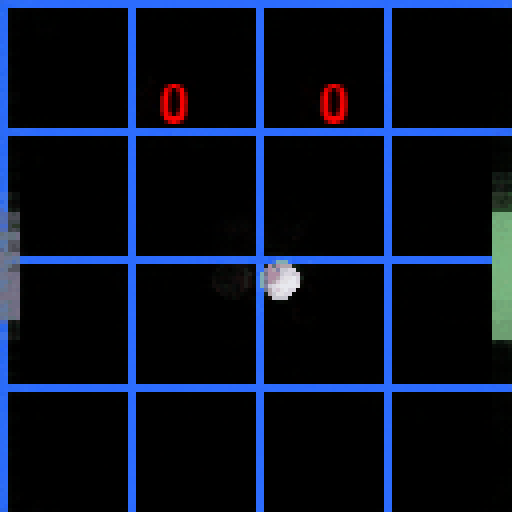

In [26]:
from IPython.display import Image as ImageD
display(ImageD(filename="play.gif"))

# Play Manually

In [27]:
import random
play_dataset = PlayDataset()
model.eval()
results = []

In [28]:
movements = ["R"] * 5 +  ["L"] * 10 +  ["R"] * 20
for i, movement in enumerate(movements):
    x = play_dataset.__getitem__()
    
    moves = x.get('moves').to(device)
    frames = x.get('frames').to(device)
    
    # Forward pass
    output = model(moves, frames)
    
    predicted_frames = output.squeeze(0).permute(0, 2, 3, 1)
    predicted_np = (predicted_frames.cpu().detach().numpy() * 255).astype('uint8')
    predicted = predicted_np[4]
    image_pil = Image.fromarray(predicted)
    play_dataset.move(movement, image_pil)
    new_size = (512, 512)  # Example new size
    image_resized = image_pil.resize(new_size, Image.NEAREST) 
    results.append(image_resized)


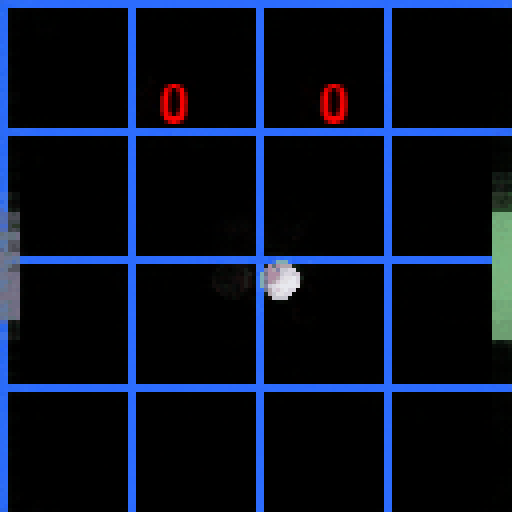

In [29]:
results[0].save("play.gif", save_all=True, append_images=results[1:], duration=0, loop=0)
from IPython.display import Image as ImageD
display(ImageD(filename="play.gif"))

# Play Train Moves Predicting frames

In [275]:
class PlayTrainDataset(Dataset):
    def __init__(self, data_folder, moves_dict, seq_len):
        self.data_folder = data_folder
        self.moves_dict = moves_dict

        self.seq_len = seq_len

        # Get a list of all image filenames in the data folder
        self.image_filenames = [filename for filename in os.listdir(data_folder) if filename.endswith('.png')]
        self.moves = [self.moves_dict[f"{i}"] for i in range(self.seq_len) if i < len(self.image_filenames) - 2]
        self.frames = [Image.open(os.path.join(self.data_folder, f'frame_{i}.png')) for i in range(self.seq_len) if i < len(self.image_filenames) - 2]
        self.counter = 4
        
    def __getitem__(self):

        frames = [data_transform_p(frame) for frame in self.frames]
        frames = torch.stack(frames).unsqueeze(0)
        moves = torch.tensor(self.moves).unsqueeze(0)

        return {'frames': frames, 'moves': moves }

    def move(self, frame):
        self.counter = self.counter + 1
        self.moves = self.moves[1:] + [self.moves_dict[f"{self.counter}"]]
        self.frames = self.frames[1:] + [frame]

data_transform_p = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor(),
])

In [279]:
play_train_dataset = PlayTrainDataset(datasetnames[0], new_moves, seq_len=5)
model.eval()
new_size = (512, 512)
results = [Image.open(os.path.join(datasetnames[0], f'frame_{i}.png')).resize(new_size, Image.NEAREST)  for i in range(5)]

In [280]:
for i in range(0, 500):
    x = play_train_dataset.__getitem__()
    
    moves = x.get('moves').to(device)
    frames = x.get('frames').to(device)
    # Forward pass
    output = model(moves, frames)
    
    predicted_frames = output.squeeze(0).permute(0, 2, 3, 1)
    predicted_np = (predicted_frames.cpu().detach().numpy() * 255).astype('uint8')
    predicted = predicted_np[4]
    image_pil = Image.fromarray(predicted)
    #display(image_pil)
    
    play_train_dataset.move(image_pil)
  # Example new size
    image_resized = image_pil.resize(new_size, Image.NEAREST) 
    results.append(image_resized)


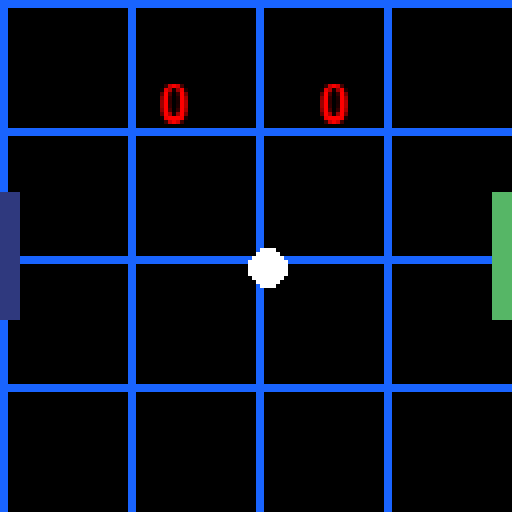

In [281]:
results[0].save("play.gif", save_all=True, append_images=results[1:], duration=0, loop=0)
from IPython.display import Image as ImageD
display(ImageD(filename="play.gif"))

# Predict next frame only

In [282]:
seq = 500
custom_dataset = CustomDataset(datasetnames[0], new_moves, seq_len=seq, transform=data_transform, transform_target=data_transform_target)
dataloader = DataLoader(custom_dataset, batch_size=1, shuffle=False, num_workers=4, pin_memory=True)
results = []

In [283]:
for batch_idx, x in enumerate(dataloader):
    if batch_idx == 0:
        frames = x['frames'].to(device)
        moves = x['moves'].to(device)
        target = x['target_frames'].to(device)
     
        if len(frames) > 0:
            for i in range(0, frames.size(1), 5):
                frames2 = frames[:, i:i + 5, :, :, :]
                moves2 = moves[:, i:i + 5]
                # Forward pass
                output = model(moves2, frames2)
                predicted_frames = output.squeeze(0).permute(0, 2, 3, 1)
                predicted_np = (predicted_frames.cpu().detach().numpy() * 255).astype('uint8')
                predicted = predicted_np[4]
                image_pil = Image.fromarray(predicted)
                new_size = (512, 512)  # Example new size
                image_resized = image_pil.resize(new_size, Image.NEAREST) 
                results.append(image_resized)
    else:
        break


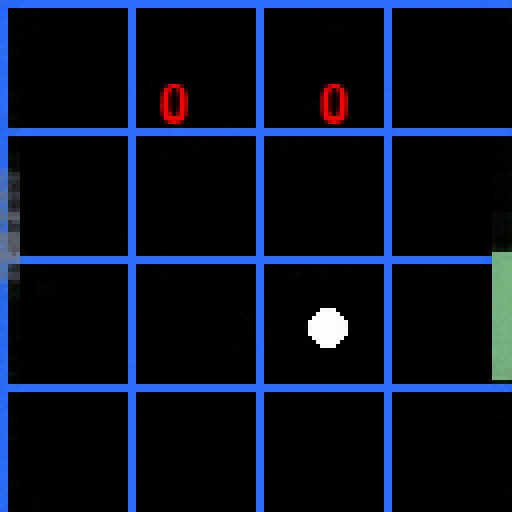

In [284]:
results[0].save("play.gif", save_all=True, append_images=results[1:], duration=1000, loop=0)
from IPython.display import Image as ImageD
display(ImageD(filename="play.gif"))